# 1. Final Project



For this project I am a real estate agent recruited by a family of four, about to relocate from Paris, France to Toronto, Canada. The client is looking to relocate in a neighborhood that is more secure than their current city.

Ideally, the client wishes to live in a family **friendly average neighborhood**, where schools(elementary and high schools) are at walking distance from their homes. As they are big foodies and love discovering new types of food, they would like to have **great diversity in restaurant options** close to their home. Both parents will be working at the **Michael Garron hospital** and wished for their commute to be no longer than 20 minutes by car.


**Problematic**: Moving from one country to another is not an easy task, particularly when one does not have a point of reference. This project will help to determine the best borough in Toronto for this family to relocate and ensure that their transition into this new life is as smooth as possible

In [1]:
import requests 
import pandas as pd 
import numpy as np 
import random 

!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim


from IPython.display import Image 
from IPython.core.display import HTML 
    

from pandas.io.json import json_normalize

!conda install -c conda-forge folium=0.5.0 --yes
import folium

print('Folium installed')
print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geopy-2.0.0                |     pyh9f0ad1d_0          63 KB  conda-forge
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    certifi-2020.6.20          |   py36h9f0ad1d_0         151 KB  conda-forge
    openssl-1.1.1g             |       h516909a_1         2.1 MB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.5 MB

The following NEW packages will be INSTALLED:

    geographiclib:   1.50-py_0          conda-forge
    geopy:           

In [2]:
!wget -q -O 'MCI_2014_to_2019.csv' https://opendata.arcgis.com/datasets/0c5fa2b642214e8baf0601405abccf30_0.csv?outSR=%7B%22latestWkid%22%3A3857%2C%22wkid%22%3A102100%7D
print('Data downloaded!')

Data downloaded!


In [3]:
#clean Toronto crimes data

crimes_df = pd.read_csv('MCI_2014_to_2019.csv')

crimes2_df = crimes_df[['MCI', 'occurrenceyear', 'Lat', 'Long', 'Neighbourhood']]
crimes2_df.dropna(subset=['occurrenceyear'])

crimes3_df = crimes2_df.loc[crimes2_df['occurrenceyear'] == 2019.0]
crimes3_df.reset_index(drop=True, inplace=True)
crimes3_df.head()

,MCI,occurrenceyear,Lat,Long,Neighbourhood
0,Assault,2019.0,43.810932,-79.227135,Malvern (132)
1,Assault,2019.0,43.663906,-79.384155,Church-Yonge Corridor (75)
2,Assault,2019.0,43.655777,-79.380676,Church-Yonge Corridor (75)
3,Assault,2019.0,43.723015,-79.415932,Bedford Park-Nortown (39)
4,Break and Enter,2019.0,43.648773,-79.528748,Islington-City Centre West (14)


## Dataframe to pass the choropleth map

In [4]:
#prepare dataframe for choropleth map, by isolating crime counts by neighbourhood 

crimes4_df = crimes3_df[['Neighbourhood', 'Lat', 'Long']]
crimes4_df.insert(3, 'Count', 1)
crimes5_df = crimes4_df[['Neighbourhood', 'Count']]
crimes5_df = crimes5_df.groupby('Neighbourhood').agg(np.sum)
crimes5_df.reset_index(level = 0, inplace = True)
crimes5_df.head()

,Neighbourhood,Count
0,Agincourt North (129),210
1,Agincourt South-Malvern West (128),309
2,Alderwood (20),85
3,Annex (95),598
4,Banbury-Don Mills (42),214


In [5]:
# prepare Paris crime data for comparative analysis with Toronto crimes

paris_crimes = {'Assault': 26299, 'Break and Enter': 13743, 'Robbery':12757, 'Theft Over': 130898, 'Other':50514}
paris = pd.Series(paris_crimes)
paris_df = pd.DataFrame(paris)
paris_df.rename(columns = {0:'Count_Paris'}, inplace = True)
paris_df

,Count_Paris
Assault,26299
Break and Enter,13743
Robbery,12757
Theft Over,130898
Other,50514


# Results

## Data Analysis

In [6]:
# Analyse type of crime in Toronto

type_df = crimes3_df['MCI'].value_counts().to_frame()
type_df

,MCI
Assault,19600
Break and Enter,8278
Auto Theft,5137
Robbery,3408
Theft Over,1251


In [7]:
# Find worst neighborhoods

Worst_Neigh_df = crimes3_df['Neighbourhood'].value_counts().to_frame()
Worst_Neigh_df.sort_values(['Neighbourhood'], ascending= False, axis=0)
Worst_Neigh_df.head(10)

,Neighbourhood
Church-Yonge Corridor (75),1396
Waterfront Communities-The Island (77),1373
Bay Street Corridor (76),1350
Moss Park (73),1066
West Humber-Clairville (1),987
Downsview-Roding-CFB (26),773
Kensington-Chinatown (78),762
York University Heights (27),703
Woburn (137),638
West Hill (136),613


In [8]:
# Find best neighborhoods

Best_Neigh_df = crimes3_df['Neighbourhood'].value_counts().to_frame()
Best_Neigh_df.sort_values(['Neighbourhood'], inplace = True)
Best_Neigh_df.head(10)

,Neighbourhood
Guildwood (140),45
Woodbine-Lumsden (60),53
Lambton Baby Point (114),57
Markland Wood (12),67
Old East York (58),71
Yonge-St.Clair (97),79
Etobicoke West Mall (13),81
Humber Heights-Westmount (8),81
Maple Leaf (29),81
Lawrence Park North (105),85


In [9]:
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt

mpl.style.use('ggplot')

print('Matplotlib version: ', mpl.__version__)

Matplotlib version:  3.0.2


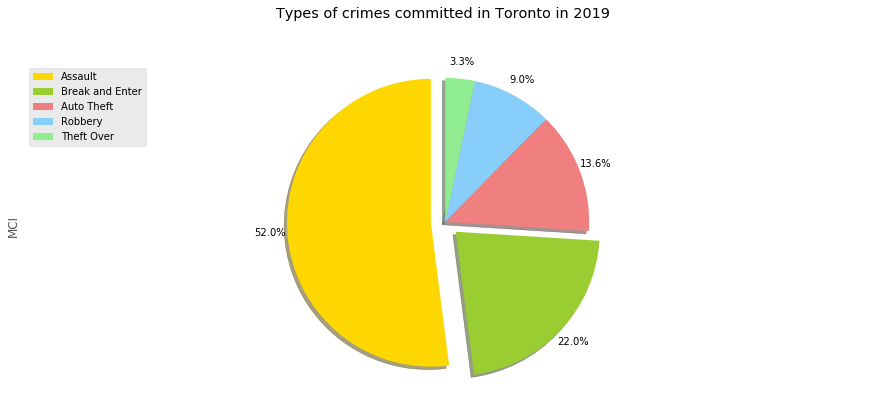

In [10]:
# Make graph of the crimes of Toronto by type

colors_list = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink']
explode_list = [0.1, 0.1, 0, 0, 0]

type_df['MCI'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,        
                            pctdistance=1.12,    
                            colors=colors_list, 
                            explode=explode_list
                            )


plt.title('Types of crimes committed in Toronto in 2019', y=1.12) 

plt.axis('equal') 

plt.legend(labels= type_df.index, loc='upper left') 

plt.show()

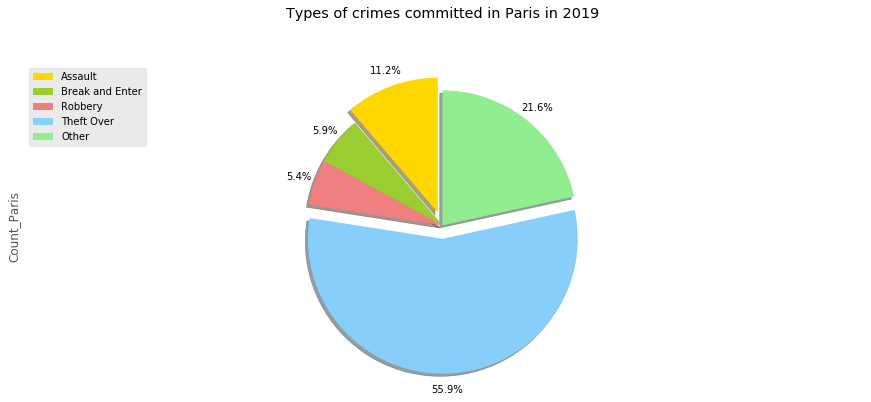

In [11]:
# Make graph of the crimes of Paris by type

colors_list2 = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'lightgreen', 'pink']
explode_list2 = [0.1, 0, 0, 0.1, 0]

paris_df['Count_Paris'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,         
                            pctdistance=1.12,    
                            colors=colors_list2,
                            explode=explode_list2
                            )

plt.title('Types of crimes committed in Paris in 2019', y=1.12) 

plt.axis('equal') 

plt.legend(labels= paris_df.index, loc='upper left') 

plt.show()

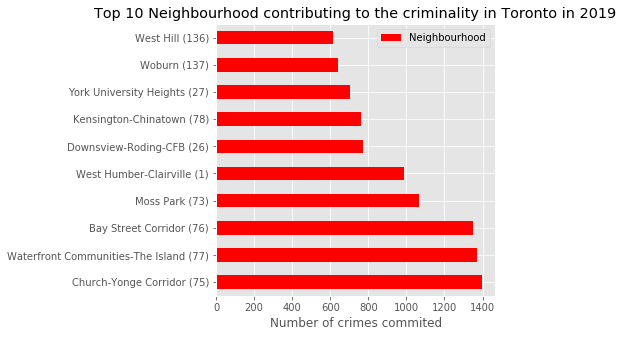

In [13]:
# Visualize worst neighbourhoods

Worst_Neigh_df[:10].plot(kind='barh', figsize=(5, 5), color='red')
plt.xlabel('Number of crimes commited')
plt.title('Top 10 Neighbourhood contributing to the criminality in Toronto in 2019')

plt.show()

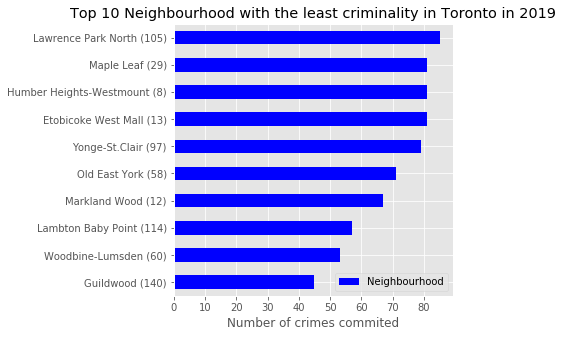

In [14]:
# Visualize best neighbourhoods

Best_Neigh_df[:10].plot(kind='barh', figsize=(5, 5), color='blue')
plt.xlabel('Number of crimes commited')
plt.title('Top 10 Neighbourhood with the least criminality in Toronto in 2019')

plt.show()

In [16]:
# Add on an interactive map, the 38 000 crimes commited in Toronto in 2019

# latitude and longiture of Toronto
latitude = 43.651070
longitude = -79.347015

from folium import plugins


map_crimes = folium.Map(location = [latitude, longitude], zoom_start = 12)

crimes = plugins.MarkerCluster().add_to(map_crimes)

for lat, lng, label, in zip(crimes3_df.Lat, crimes3_df.Long, crimes3_df.MCI):
    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(crimes)

map_crimes

In [17]:
#download Toronto neighbourhood delimitations

!wget --quiet 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=geojson&projection=4326' -O Neighbourhoods.geojson
    
print('GeoJSON file downloaded!')

GeoJSON file downloaded!


In [18]:
# pass all crimes on a cholopleth map 

toronto_geo = r'Neighbourhoods.geojson'

toronto_map = folium.Map(location = [latitude, longitude], zoom_start = 12, tiles='Mapbox Bright')

toronto_map.choropleth(
    geo_data=toronto_geo,
    data=crimes5_df,
    columns=['Neighbourhood', 'Count'],
    key_on='feature.properties.AREA_NAME',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Crimes in Toronto'
)
toronto_map

In [19]:
# Define a dataframe for neighborhoods with >85 crimes or less 

lat_coordinates = {'Guildwood (140)': 43.7552251, 
               'Woodbine-Lumsden (60)': 43.69992, 
               'Lambton Baby Point (114)':43.6558741,
               'Markland Wood (12)':43.63123865,
               'Old East York (58)':43.699971000000005,
               'Yonge-St.Clair (97)':43.6880189, 
               'Etobicoke West Mall (13)':43.6435491,
               'Maple Leaf (29)':43.7122767,
               'Humber Heights-Westmount (8)':42.9510358,
               'Alderwood (20)': 43.6017173, 
               'Lawrence Park North (105)':44.24463705}

long_coordinates = {'Guildwood (140)': -79.1982293, 
               'Woodbine-Lumsden (60)': -79.319279,
               'Lambton Baby Point (114)':-79.4964941,
               'Markland Wood (12)':-79.58543401986114,
               'Old East York (58)':-79.33251996261595,
               'Yonge-St.Clair (97)': -79.3945708,
               'Etobicoke West Mall (13)': -79.56532534553605,
               'Maple Leaf (29)': -79.4901977, 
               'Humber Heights-Westmount (8)': -81.2898857, 
               'Alderwood (20)': -79.5452325, 
               'Lawrence Park North (105)': -76.61765730030677}

total = {'Guildwood (140)': 45, 
               'Woodbine-Lumsden (60)':53,
               'Lambton Baby Point (114)':57,
               'Markland Wood (12)':67,
               'Old East York (58)':71,
               'Yonge-St.Clair (97)': 79,
               'Etobicoke West Mall (13)': 81,
               'Maple Leaf (29)': 81, 
               'Humber Heights-Westmount (8)':81, 
               'Alderwood (20)': 85, 
               'Lawrence Park North (105)': 85}

lat_c = pd.Series(lat_coordinates)
lat_c_df = pd.DataFrame(lat_c)
lat_c_df.rename(columns = {0:'Lat'}, inplace = True)
lat_c_df.reset_index(level = 0, inplace = True)
lat_c_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

long_c = pd.Series(long_coordinates)
long_c_df = pd.DataFrame(long_c)
long_c_df.rename(columns = {0:'Long'}, inplace = True)
long_c_df.reset_index(level = 0, inplace = True)
long_c_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

tot = pd.Series(total)
tot_df = pd.DataFrame(tot)
tot_df.rename(columns = {0:'Count'}, inplace = True)
tot_df.reset_index(level = 0, inplace = True)
tot_df.rename(columns = {'index':'Neighbourhood'}, inplace = True)

In [20]:
Neighb_df = lat_c_df.merge(long_c_df, how = 'inner', on = ['Neighbourhood', 'Neighbourhood'])
Final_df = Neighb_df.merge(tot_df, how = 'inner', on = ['Neighbourhood', 'Neighbourhood'])
Final_df

,Neighbourhood,Lat,Long,Count
0,Guildwood (140),43.755225,-79.198229,45
1,Woodbine-Lumsden (60),43.699920,-79.319279,53
2,Lambton Baby Point (114),43.655874,-79.496494,57
3,Markland Wood (12),43.631239,-79.585434,67
4,Old East York (58),43.699971,-79.332520,71
5,Yonge-St.Clair (97),43.688019,-79.394571,79
6,Etobicoke West Mall (13),43.643549,-79.565325,81
7,Maple Leaf (29),43.712277,-79.490198,81
8,Humber Heights-Westmount (8),42.951036,-81.289886,81
9,Alderwood (20),43.601717,-79.545232,85


In [21]:
# add these neighborhoods only on a choropleth map and add a circle marker around the Michael Garron Hospital to delimitate the 10km radius region around it

toronto_geo = r'Neighbourhoods.geojson'

toronto_map1 = folium.Map(location = [latitude, longitude], zoom_start = 12, tiles='Mapbox Bright')

#latitude and longitude of the Michael Garron Hospital
lat_work  = 43.6898
lon_work = -79.3257

toronto_map1.choropleth(
    geo_data=toronto_geo,
    data=Final_df,
    columns=['Neighbourhood', 'Count'],
    key_on='feature.properties.AREA_NAME',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Crimes in Torontoès Best Neighbourhoods'
)

folium.Marker([lat_work, lon_work]).add_to(toronto_map1)
folium.Circle([lat_work, lon_work],
                    radius=10000
                   ).add_to(toronto_map1)
toronto_map1

In [19]:
# create a dataframe that only contains the neighborhoods selected for further analysis

foursquare_df = Final_df.drop([0,2,3,6,7,8,9])
foursquare_df

,Neighbourhood,Lat,Long,Count
1,Woodbine-Lumsden (60),43.699920,-79.319279,53
4,Old East York (58),43.699971,-79.332520,71
5,Yonge-St.Clair (97),43.688019,-79.394571,79
10,Lawrence Park North (105),44.244637,-76.617657,85


# Using the foursquare API

In [156]:
CLIENT_ID = '' 
CLIENT_SECRET = '' 
VERSION = '20180604'
LIMIT = 30

In [21]:
# get all venues for the selected 4 neighborhoods

def getNearbyVenues(names, latitudes, longitudes, radius=3000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [22]:
all_venues = getNearbyVenues(names=foursquare_df['Neighbourhood'],
                                   latitudes=foursquare_df['Lat'],
                                   longitudes=foursquare_df['Long']
                                  )

Woodbine-Lumsden (60)
Old East York (58)
Yonge-St.Clair (97)
Lawrence Park North (105)


In [23]:
print(all_venues.shape)
all_venues.head()

(100, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Woodbine-Lumsden (60),43.69992,-79.319279,Taylor Creek Park,43.696599,-79.306693,Park
1,Woodbine-Lumsden (60),43.69992,-79.319279,Knuckle Sandwich,43.696194,-79.328749,Sandwich Place
2,Woodbine-Lumsden (60),43.69992,-79.319279,Toronto Climbing Academy,43.709362,-79.315006,Rock Climbing Spot
3,Woodbine-Lumsden (60),43.69992,-79.319279,Jawny Bakers,43.705783,-79.312913,Gastropub
4,Woodbine-Lumsden (60),43.69992,-79.319279,Royal Beef,43.685325,-79.314982,Butcher


In [24]:
all_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Lawrence Park North (105),10,10,10,10,10,10
Old East York (58),30,30,30,30,30,30
Woodbine-Lumsden (60),30,30,30,30,30,30
Yonge-St.Clair (97),30,30,30,30,30,30


### Exclude Laurence Park North because not enough venues

## Yonge St-Clair

In [137]:
# look for school for Yonge St clair

Yonge = 'Yonge-St. Clair, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Yonge)
latitude = location.latitude
longitude = location.longitude

search_query = 'school'
radius = 1000

In [138]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query, radius, LIMIT)

results = requests.get(url).json()

In [139]:
yonge_venues = results['response']['venues']

yonge_df = json_normalize(yonge_venues)
yonge_df.shape

(13, 18)

In [140]:
filtered_yonge = ['name', 'categories'] + [col for col in yonge_df.columns if col.startswith('location.')] + ['id']
filtered_df = yonge_df.loc[:, filtered_yonge]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filtered_df['categories'] = filtered_df.apply(get_category_type, axis=1)


filtered_df.columns = [column.split('.')[-1] for column in filtered_df.columns]

yonge_sch_df = filtered_df[['name', 'categories', 'crossStreet', 'distance']]
School_1_df = yonge_sch_df.drop([0,1,3,4,5,9,12]) #drop all that are not elementary or high school
School_1_df.reset_index(level = 0, inplace = True)
School_1_df = School_1_df[['name', 'categories', 'crossStreet', 'distance']]
School_1_df

,name,categories,crossStreet,distance
0,Avenue Road Arts School,School,Lynwood Avenue,830
1,The York School - Junior School,School,NaN,433
2,The York School - Lower Campus,School,NaN,443
3,The York School,School,NaN,391
4,Brown Jr Public School,Elementary School,NaN,616
5,Our Lady Of Perpetual Help Catholic School,School,NaN,851


In [141]:
# look for restaurants for Yonge St clair
yonge_rest = 'restaurant'
radius = 2000

url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, yonge_rest, radius, LIMIT)
results = requests.get(url).json()
yonge_rest = results['response']['venues']

yonge_df = json_normalize(yonge_rest)

In [142]:
filtered_rest = ['name', 'categories'] + [col for col in yonge_df.columns if col.startswith('location.')] + ['id']
filteredyonge_rest_df = yonge_df.loc[:, filtered_rest]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filteredyonge_rest_df['categories'] = filteredyonge_rest_df.apply(get_category_type, axis=1)


filteredyonge_rest_df.columns = [column.split('.')[-1] for column in filteredyonge_rest_df.columns]

yonge_fin_df = filteredyonge_rest_df[['name', 'categories', 'crossStreet', 'distance']]
yonge_fin_df.head()

,name,categories,crossStreet,distance
0,Bikkuri Japanese Restaurant,Japanese Restaurant,at Balliol St,970
1,Arthur’s Restaurant,Steakhouse,Yonge St,95
2,Figs Restaurant Bar & Grill,None,NaN,130
3,ONE Restaurant/Lounge,New American Restaurant,at Hazelton Ave.,1918
4,Kwan Restaurant,Cantonese Restaurant,St. Clair,81


In [143]:
type_yonge_df = yonge_fin_df['categories'].value_counts().to_frame()
type_yonge_df

,categories
Chinese Restaurant,4
Indian Restaurant,3
Restaurant,3
Japanese Restaurant,2
Italian Restaurant,2
Cantonese Restaurant,1
Eastern European Restaurant,1
Thai Restaurant,1
Sushi Restaurant,1
Diner,1


## Woodbine-Lumsden

In [144]:
# look for school for Woodbine-Lumsden

Woodbine_Heights = 'Woodbine Heights, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Woodbine_Heights)
latitude = location.latitude
longitude = location.longitude

search_query2 = 'school'
radius = 1000

In [145]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query2, radius, LIMIT)

results = requests.get(url).json()

wood_venues = results['response']['venues']

wood_df = json_normalize(wood_venues)
wood_df.shape

(6, 17)

In [146]:
filtered_wood = ['name', 'categories'] + [col for col in wood_df.columns if col.startswith('location.')] + ['id']
filteredwood_df = wood_df.loc[:, filtered_wood]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filteredwood_df['categories'] = filteredwood_df.apply(get_category_type, axis=1)


filteredwood_df.columns = [column.split('.')[-1] for column in filteredwood_df.columns]

wood_sch_df = filteredwood_df[['name', 'categories', 'crossStreet', 'distance']]
School_2_df = wood_sch_df.drop([0,5]) #drop all that are not elementary or high school
School_2_df.reset_index(level = 0, inplace = True)
School_2_df = School_2_df[['name', 'categories', 'crossStreet', 'distance']]
School_2_df

,name,categories,crossStreet,distance
0,Parkside Elementary School,School,NaN,249
1,DA Morrison Public School,High School,NaN,845
2,Alternative School,High School,Cosburn & Coxwell,1047
3,Cosburn Middle School,School,Durant Ave,1127


In [147]:
# look for rest for Woodbine-Lumsden

wood_rest = 'restaurant'
radius = 2000

url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, wood_rest, radius, LIMIT)
results = requests.get(url).json()
wood_rest = results['response']['venues']

wood_rest_df = json_normalize(wood_rest)

In [148]:
filtered_wood_rest = ['name', 'categories'] + [col for col in wood_rest_df.columns if col.startswith('location.')] + ['id']
filteredwood_rest_df = wood_rest_df.loc[:, filtered_wood_rest]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filteredwood_rest_df['categories'] = filteredwood_rest_df.apply(get_category_type, axis=1)


filteredwood_rest_df.columns = [column.split('.')[-1] for column in filteredwood_rest_df.columns]

wood_fin_df = filteredwood_rest_df[['name', 'categories', 'crossStreet', 'distance']]
wood_fin_df.head()

,name,categories,crossStreet,distance
0,Abugida Restaurant & Lounge,Ethiopian Restaurant,Monarch Park Ave,2073
1,Caribbean Palms Restaurant,Caribbean Restaurant,NaN,1969
2,Restaurant Asal,Restaurant,NaN,2117
3,#27 restaurant,American Restaurant,NaN,1174
4,Little Coxwell Restaurant,Thai Restaurant,at Plains Rd,883


In [149]:
type_wood_df = wood_fin_df['categories'].value_counts().to_frame()
type_wood_df

,categories
Chinese Restaurant,5
Ethiopian Restaurant,4
Middle Eastern Restaurant,2
Indian Restaurant,2
Restaurant,2
Burger Joint,2
Caribbean Restaurant,2
Hungarian Restaurant,1
Breakfast Spot,1
Asian Restaurant,1


## Old East York

In [150]:
# look for school for Old East York

OEY = 'Old East York, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(OEY)
latitude = location.latitude
longitude = location.longitude

search_query3 = 'school'
radius = 1000

In [151]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, search_query3, radius, LIMIT)

results = requests.get(url).json()

oey_venues = results['response']['venues']

oey_df = json_normalize(oey_venues)
oey_df.shape

(7, 17)

In [152]:
filtered_oey = ['name', 'categories'] + [col for col in oey_df.columns if col.startswith('location.')] + ['id']
filteredoey_df = oey_df.loc[:, filtered_oey]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filteredoey_df['categories'] = filteredoey_df.apply(get_category_type, axis=1)


filteredoey_df.columns = [column.split('.')[-1] for column in filteredoey_df.columns]

oey_sch_df = filteredoey_df[['name', 'categories', 'crossStreet', 'distance']]
School_3_df = oey_sch_df.drop([0,2,3]) #drop all that are not elementary or high school
School_3_df.reset_index(level = 0, inplace = True)
School_3_df = School_3_df[['name', 'categories', 'crossStreet', 'distance']]
School_3_df

,name,categories,crossStreet,distance
0,Cosburn Middle School,School,Durant Ave,653
1,Alternative School,High School,Cosburn & Coxwell,801
2,R.H. McGregor Elementary School,School,at Coxwell Ave,1248
3,Holy Cross Catholic School,School,NaN,1228


In [153]:
# look for rest for Old East York

oey_rest = 'restaurant'
radius = 2000

url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, oey_rest, radius, LIMIT)
results = requests.get(url).json()
oey_rest = results['response']['venues']

oey_rest_df = json_normalize(oey_rest)

In [154]:
filtered_oey_rest = ['name', 'categories'] + [col for col in oey_rest_df.columns if col.startswith('location.')] + ['id']
filteredoey_rest_df = oey_rest_df.loc[:, filtered_oey_rest]


def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


filteredoey_rest_df['categories'] = filteredoey_rest_df.apply(get_category_type, axis=1)


filteredoey_rest_df.columns = [column.split('.')[-1] for column in filteredoey_rest_df.columns]

oey_fin_df = filteredoey_rest_df[['name', 'categories', 'crossStreet', 'distance']]
oey_fin_df.head()

,name,categories,crossStreet,distance
0,Caribbean Palms Restaurant,Caribbean Restaurant,NaN,1569
1,Red Chili Thai Restaurant,Thai Restaurant,at Greenwood Ave.,2013
2,Abugida Restaurant & Lounge,Ethiopian Restaurant,Monarch Park Ave,2005
3,Sunshine Caribbean Restaurant,Caribbean Restaurant,Donlands Ave,2185
4,Makkah Restaurant,Restaurant,NaN,2176


In [155]:
type_oey_df = oey_fin_df['categories'].value_counts().to_frame()
type_oey_df

,categories
Chinese Restaurant,5
Ethiopian Restaurant,4
Caribbean Restaurant,3
Greek Restaurant,3
Restaurant,3
Thai Restaurant,2
Middle Eastern Restaurant,2
American Restaurant,1
African Restaurant,1
Indian Restaurant,1


# Index

In [85]:
Yonge = 'Yonge-St. Clair, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Yonge)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Yonge-St. Clair are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Yonge-St. Clair are 43.6880189, -79.3945708.


In [62]:
Woodbine_Heights = 'Woodbine Heights, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Woodbine_Heights)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Woodbine Heights are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Woodbine Heights are 43.69992, -79.319279.


In [63]:
Markland_Wood = 'Markland Wood, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Markland_Wood)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Markland_Wood are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Markland_Wood are 43.63123865, -79.58543401986114.


In [65]:
Yonge = 'Yonge-St. Clair, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Yonge)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Yonge-St. Clair are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Yonge-St. Clair are 43.6880189, -79.3945708.


In [66]:
Humber = 'Humber Heights-Westmount, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Humber)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Humber Heights-Westmount are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Humber Heights-Westmount are 43.6968603, -79.52592390089058.


In [149]:
Etobicoke = 'Etobicoke West Mall, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Etobicoke)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Etobicoke West Mall are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Etobicoke West Mall are 43.6435491, -79.56532534553605.


In [150]:
Baby_Point = 'Baby Point, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Baby_Point)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Baby_Point are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Baby_Point are 43.6558741, -79.4964941.


In [153]:
HEW = 'Westmount, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(HEW)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of HEW are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of HEW are 42.9510358, -81.2898857.


In [152]:
ML = 'Maple Leaf, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(ML)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of ML are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of ML are 43.7122767, -79.4901977.


In [154]:
Ald = 'Alderwood, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(Ald)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Ald are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Ald are 43.6017173, -79.5452325.


In [155]:
LPN = 'Lawrence Park North, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(LPN)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of LPN are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of LPN are 44.24463705, -76.61765730030677.


In [156]:
OEY = 'Old East York, ON'

geolocator = Nominatim(user_agent="coursera-capstone-project")
location = geolocator.geocode(OEY)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of OEY are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of OEY are 43.699971000000005, -79.33251996261595.
